# Đồ án môn học Lập trình song song ứng dụng

# Phát hiện khuôn mặt bằng Cascaded-Classifiers

## Giáo viên: Trần Trung Kiên

### Sinh viên:
- 1712628 - Huỳnh Hiếu Nhân
- 1712657 - Chung Kiệt Phong
- 1712869 - Đào Duy Tuấn

---

# 0. Import

In [24]:
import cv2 as cv
from google.colab.patches import cv2_imshow

---

# 1. Mô tả ứng dụng

- Ứng dụng mà nhóm chọn là Phát hiện khuôn mặt bằng Cascaded-Classifiers
	- Input: một tấm ảnh RGB, mô hình Haar Cascade Classifier đã train sẵn
	- Output: tấm ảnh đầu vào có bounding box ở các khuôn mặt trong ảnh (nếu có)
	- Ý nghĩa của ứng dụng trong thực tế:
		- Hỗ trợ tính năng autofocus trên máy ảnh
		- Là bước quan trọng trong các hệ thống sử dụng nhận diện khuôn mặt: giám sát, an ninh, cơ sở dữ liệu, chăm sóc khách hàng ...
		- Ứng dụng để tự động đề xuất gắn thẻ cho ảnh trên mạng xã hội
- Lý do cần tăng tốc ứng dụng:
	- Có nhiều ý nghĩa thực tế
	- Ứng dụng sẽ chạy chậm nếu cài đặt tuần tự
	- Nhu cầu xử lý dữ liệu lớn, ảnh có độ phân giải cao, video, streaming video trong thời gian thực
- Tiềm năng song song hóa của ứng dụng: 
  - Các khung cửa sổ để phát hiện khuôn mặt ở mọi vị trí trong ảnh và các kích thước khác nhau của khung cửa số xử lý độc lập với nhau
  - Tính tuần tự của các giai đoạn kiểm tra có thách thức lớn nhưng tốc độ xử lý được gia tăng đáng kể nếu có thể song song hóa phần này

---

# 2. Cài đặt tuần tự

## 2.1. Thiết kế

**Cascade Classifier**

Cascade Classifier là một bộ phân lớp nhận vào một vùng ảnh và cho biết vùng ảnh đó có phải là khuôn mặt hay không. Quá trình đưa ra dự đoán của bộ phân lớp này được chia thành các Stage, mỗi Stage có một Weak Classifier như sau:

![cascaded-classifiers.png](https://raw.githubusercontent.com/ddtuan99/parallel-face-detection/main/assets/cascaded-classifiers.png)

Vùng ảnh sẽ lần lượt đi qua các Stage, khi một Stage chấp nhận nó sẽ được truyền sang Stage tiếp theo và nếu nó vượt qua Stage cuối cùng thì nó được ghi nhận là một khuôn mặt. Ngược lại, khi một vùng ảnh bị loại bỏ ở một Stage nào đó, quá trình sẽ dừng lại, các Stage sau sẽ không cần xử lý vùng ảnh này.

Weak Classifier của mỗi Stage được huấn luyện để có thể phân lớp với tỉ lệ false negative thấp nhưng false positive có thể cao. Nghĩa là nó chỉ có thể phân loại một vùng ảnh là có-thể-là-khuôn-mặt hay không phải là khuôn mặt. Các Stage ở sau sẽ cố gắng để loại bỏ những vùng ảnh không phải là khuôn mặt mà Stage trước để lọt qua, do đó các Stage ở sau thường phức tạp và cần nhiều tài nguyên hơn để thực thi so với Stage trước.

Mục tiêu của kiến trúc này là giúp việc kiểm tra một vùng ảnh không phải là mặt người tốn ít thời gian nhất có thể. Vì thời gian để kiểm tra một vùng ảnh qua hết các Stage là không thấp, quá trình nhận diện khuôn mặt trong ảnh sẽ phải kiểm tra các vùng ảnh ở mọi vị trí và nhiều kích thước có thể trong bức ảnh nên số lượng vùng ảnh không phải là khuôn mặt lớn hơn rất nhiều so với số lượng vùng ảnh là khuôn mặt. Điều này có thể được kiểm chứng qua thực nghiệm và cũng được nhắc tới trong bài báo của Viola - Jones:
> The structure of the cascade reflects the fact that within any single image an overwhelming majority of sub-windows are negative. As such, the cascade attempts to reject as many negatives as possible at the earliest stage possible. While a positive instance will trigger the evaluation of every classifier in the cascade, this is an exceedingly rare event.

Thông qua quá trình chạy các cài đặt nhóm em quan sát thấy điều trên là đúng, ở các ảnh được thí nghiệm thì tỉ lệ vùng ảnh không phải là khuôn mặt trên tổng số vùng ảnh được kiểm tra là 99.99%. Ngoài ra, nhóm em cũng có thí nghiệm thêm với 1 tấm ảnh được ghép từ nhiều ảnh mặt người cũng cho kết quả tương tự.

**Haar-like feature**

Cascade Classifier cần các đặc trưng để nhận biết một vùng có phải là khuôn mặt hay không. Haar-like feature là bộ đặc trưng thường được dùng cho Cascade Classifier (cũng như trong đồ án này). Bộ đặc trưng này phản ảnh đặc tính rất đơn giản trên mặt người, đó là một số vùng trên khuôn mặt sẽ có sự chênh lệch độ sáng nhất định. Ví dụ hai Haar-like feature:

![haar-like-feature.png](https://raw.githubusercontent.com/ddtuan99/parallel-face-detection/main/assets/haar-like-feature.png)

Feature đầu tiên dựa trên đặc tính vùng mắt thường tối màu hơn vùng mũi và má, feature thứ hai dựa trên đặc tính vùng mắt thường tối hơn vùng sóng mũi. Một cách đơn giản, feature được tính bằng độ chênh lệch độ sáng của pixel trong vùng đen và trắng (trong hình chữ nhật ở ví dụ trên), khi đo lệnh đó đủ một ngưỡng nhất định thì vùng ảnh có khả năng là khuôn mặt. Để đưa ra phân lớp chắc chắn, cần một số lượng lớn feature. Có 4 loại haar-like feature cơ bản:

![haar-features.png](https://raw.githubusercontent.com/ddtuan99/parallel-face-detection/main/assets/haar-features.png)

Một feature cụ thể của một loại feature được định nghĩa bởi vị trí của nó trong khung cửa sổ tìm kiếm, kích thước chiều ngang, dọc, trọng số cho vùng đen, trắng và threshold. Với 4 loại feature trên và xét vị trí, kích thước tự do trong cửa sổ 24x24 thì đã có hơn 160.000 feature cụ thể. Mô hình Ada Boost được dùng để chọn ra một tập các feature thật sự có ích cho bộ phân lớp và đồng thời học threshold tối ưu cho mỗi feature.

Sự phức tạp và thời gian tính toán của một Stage phụ thuộc vào số feature mà Weak Classifier của Stage cần phải tính. Như đã đề cập ở phần trên thì có nghĩa là Weak Classifier ở Stage sau thường sẽ có nhiều feature cần tính hơn ở Stage trước.

**Summed Area Table**

Thao tác chính để tính một feature là tính tổng các pixel trong một hình chữ nhật. Một Cascade Classifier được train sẵn từ OpenCV có tới 2, 3 ngàn feature. Khung cửa sổ tìm kiếm khuôn mặt sẽ phải tăng kích thước để tìm kiếm khuôn mặt không biết trước kích thước và do đó kích thước của feature trong khung cửa sổ cũng tăng theo. Cần một cách để tính nhanh tổng các pixel trong một hình chữ nhật.

Giải pháp là Summed Area Table (SAT) hay còn gọi là Integral Image. SAT à một ma trận có kích thước như ảnh đầu vào. Giá trị tại vị trí $(x, y)$ của bảng SAT được tính bằng tổng độ xám của các pixel trong hình chữ nhật có tọa độ 2 góc đối là $(0, 0)$ và $(x, y)$.

Minh họa Summed Area Table và cách để tính tổng của một vùng hình chữ nhật với mọi kích cỡ chỉ với 3 phép toán:

![summed-area-table.png](https://raw.githubusercontent.com/ddtuan99/parallel-face-detection/main/assets/summed-area-table.png)

**Các bước triển khai cụ thể**

- Input: mô hình Haar Cascade Classifier đã train sẵn, một tấm ảnh màu hoặc ảnh xám

- Bước 1: Đọc mô hình từ dạng văn bản vào cấu trúc dữ liệu thích hợp

- Bước 2: Chuyển ảnh đầu vào sang ảnh xám (nếu cần)

- Bước 3: Tính Summed Area Table (SAT) từ ảnh xám đầu vào. Duyệt từng dòng của ảnh xám, mỗi dòng duyệt các pixel từ trái sang phải, giá trị của SAT tại pixel ở dòng $i$, cột $j$ được tính bằng công thức:
$\text{SAT}(i, j) = \text{SAT}(i - 1, j) + \text{PREFIX_SUM}(i, j)$ với $\text{SAT}(-1, j) = 0$ và $\text{PREFIX_SUM}(i, j)$ là prefix sum của dòng $i$ đến phần tử thứ $j$.

- Bước 4: Tại mọi vị trí $(x, y)$ trên ảnh xám, khung cửa sổ có góc trái trên tại đây (với kích thước ban đầu qui định bởi mô hình) nếu có phần diện tích nằm trọn ven trong bức ảnh thì vùng ảnh trong khung sẽ được đưa vào Cascade Classifier để phân loại có phải là mặt người hay không.
	- Vùng ảnh sẽ lần lượt đi qua các Stage, Weak Classifier sẽ tính các feature thuộc Stage này và tổng hợp lại kết quả để so sánh với threshold của Stage. Nếu đạt ngưỡng thì vùng ảnh tiếp tục được chuyển qua Stage tiếp theo, nếu không thì vùng ảnh sẽ bị loại bỏ.
	- Nếu vùng ảnh vượt qua Stage cuối cùng thì nó được ghi nhận là mặt người.
    
- Bước 5: Tăng kích thước khung cửa sổ sử dụng ở Bước 4, so sánh chiều ngang hoặc dọc của khung cửa sổ với ảnh đầu vào:
    - Nếu chưa vượt quá thì tiến hành scale các feature  theo tỉ lệ kích thước hiện tại so với ban đầu của khung cửa sổ và lặp lại Bước 4.
    - Nếu không, sang bước tiếp theo.

- Bước 6: Gom nhóm các khung cửa sổ phát hiện cùng một khuôn mặt. Hai khung cửa sổ có khoảng cách giữa các cạnh tương ứng đều nhỏ hơn một hằng số $\epsilon$ chỉ định trước thì thuộc cùng một nhóm và ngược lại. Tiếp theo:
    - Loại bỏ các nhóm có số khung cửa sổ thấp hơn ngưỡng chỉ định trước (giảm false positive).
    - Ở mỗi nhóm được giữ lại, tính trung bình tọa độ các khung cửa sổ trong nhóm để gộp các khung thành một bounding box duy nhất và vẽ lên ảnh kết quả.
    
- Output: Tấm ảnh đầu vào có bounding box ở các khuôn mặt trong ảnh

## 2.2. Đánh giá

**Kịch bản thí nghiệm:**
  - Host: Intel(R) Xeon(R) CPU @ 2.30GHz
  - Đo thời gian chạy của chương trình được thực hiện bằng [timeit.default_timer()](https://docs.python.org/3/library/timeit.html#timeit.default_timer). Bắt đầu tính thời gian chạy sau khi đã đọc xong mô hình và kết thúc tính giờ sau khi đã vẽ các bouding box lên ảnh kết quả. Chương trình được chạy lại một vài lần đầu để loại bỏ thời gian biên dịch của các hàm jiited.
  - Các tham số mặc định của chương trình được thiết lập giống với mô tả của OpenCV [tại đây](https://docs.opencv.org/3.4/d1/de5/classcv_1_1CascadeClassifier.html#aaf8181cb63968136476ec4204ffca498).
  - Mô hình Haar Cascade `haarcascade_frontalface_alt.xml` đã train sẵn của tác giả Rainer Lienhart được OpenCV cung cấp [tại đây](https://github.com/opencv/opencv/blob/651967b95c852ebf4b751746197049ee558fe450/data/haarcascades/haarcascade_frontalface_alt.xml).
  - [Ảnh đầu vào](https://drive.google.com/file/d/1--7bbjV_nGoaC62ZHpCrJ5np0mPD7-ss/view) (chạy trong notebook này) có kích thước 2000x1403, có 11 khuôn mặt.

**Chạy code xem kết quả:**

In [25]:
!python sequential.py haarcascade_frontalface_alt.xml img1.jpg out_sequential.jpg

Image size (width x height): 2000 x 1403

Number of candidates: 9810931
Number of detections: 736 

Total time on host: 8535.027965 ms

Convert rgb to grayscale error:
 - Jitted vs Numpy:  0.0006179615110477548
 - Jitted vs Opencv: 0.47841304347826086
Calculate SAT: Pass


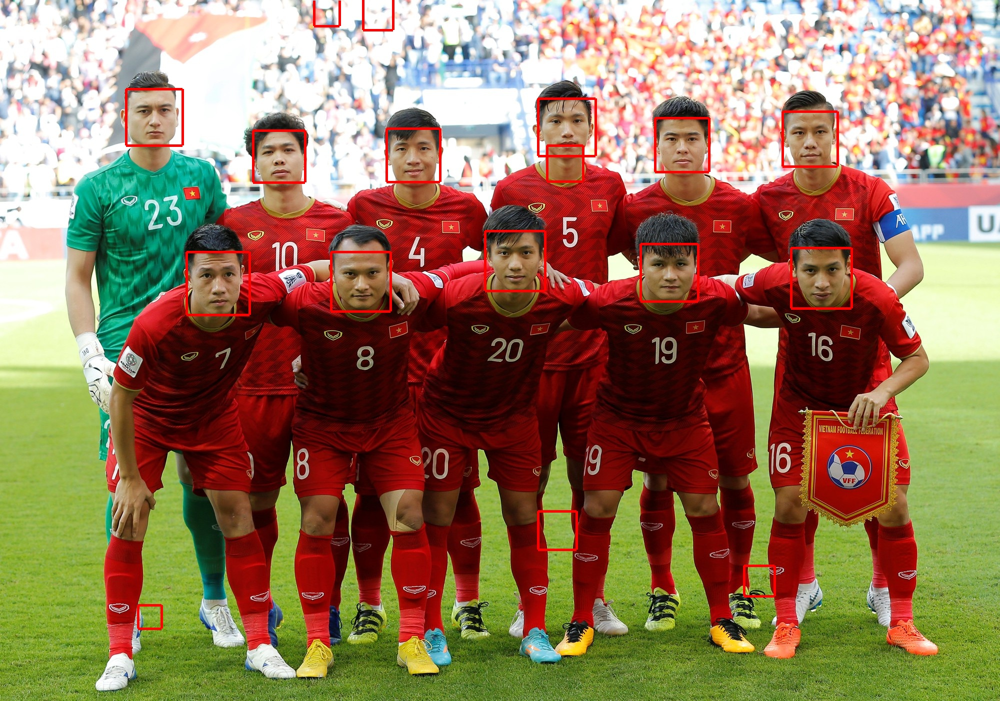

In [26]:
cv2_imshow(cv.imread('out_sequential.jpg'))

Kết quả với một số ảnh khác:

| OpenCV | Nhóm |
| :---: | :---: |
| ![out1_opencv.jpg](https://raw.githubusercontent.com/ddtuan99/parallel-face-detection/main/results/out1_opencv.jpg) | ![out1.jpg](https://raw.githubusercontent.com/ddtuan99/parallel-face-detection/main/results/out1.jpg) |
| ![out2_opencv.jpg](https://raw.githubusercontent.com/ddtuan99/parallel-face-detection/main/results/out2_opencv.jpg) | ![out2.jpg](https://raw.githubusercontent.com/ddtuan99/parallel-face-detection/main/results/out2.jpg) |
| ![out3_opencv.jpg](https://raw.githubusercontent.com/ddtuan99/parallel-face-detection/main/results/out3_opencv.jpg) | ![out3.jpg](https://raw.githubusercontent.com/ddtuan99/parallel-face-detection/main/results/out3.jpg) |
| ![out4_opencv.jpg](https://raw.githubusercontent.com/ddtuan99/parallel-face-detection/main/results/out4_opencv.jpg) | ![out4.jpg](https://raw.githubusercontent.com/ddtuan99/parallel-face-detection/main/results/out4.jpg) |

Các ảnh kết quả thí nghiệm với cài đặt của nhóm, OpenCV, [Tracking.js](https://github.com/eduardolundgren/tracking.js) (một thư viện JavaScript) và nguồn ảnh được lưu [tại đây](https://drive.google.com/drive/folders/175bkO_eKiTlTeSeVOg1La3YJ3LpoZ00u).

**Nhận xét:** Kết quả nhìn chung cho độ chính xác khá tốt. Trong các ảnh được thí nghiệm, tỉ lệ phát hiện khuôn mặt là ngang với OpenCV, có 1 ảnh kém hơn 1 khuôn mặt và một vài ảnh thậm chí phát hiện nhiều hơn OpenCV. Kích thước, vị trí bouding box có phần khác, số lượng false positive có phần nhiều hơn so với kết quả của OpenCV.

**Tính đúng đắn:**
- Mọi thành viên trong nhóm đều tự cài đặt độc lập một phiên bản và cùng cho ra kết quả giống nhau.
- Hàm tính SAT (Integral Image) được kiểm tra với OpenCV.
- Các yếu tố gây ra sự khác biệt so với kết quả của OpenCV:
	- Ý tưởng cài đặt của nhóm bám sát bài báo của Viola - Jones:
	> The final detector is scanned across the image at multi-ple scales and locations. Scaling is achieved by scaling the detector itself, rather than scaling the image. This process makes sense because the features can be evaluated at any scale with the same cost.
	
	Đó là scale các feature thay vì scale ảnh (và phải tính lại SAT) giống như Opencv.
	- Nguyên nhân khác mà nhóm chưa tìm hiểu ra vì chưa hoàn toàn hiểu hết source code của OpenCV.

---

# 3. Cài đặt song song

## 3.1. Phân tích

Các bước được thực hiện song song hóa:
- Chuyển ảnh màu sang ảnh xám: mỗi phần tử ảnh xám có thể được tính độc lập do đó ta song song hóa để cải thiện thời gian chạy. Độ phức tạp về mặt thời gian trên lý thuyết đạt được khi song song hóa giảm còn O(1) so với O(width x height) khi cài đặt tuần tự.
- Tính SAT: cài đặt tuần tự có độ phức tạp thời gian O(width x height) sẽ chậm nếu ảnh lớn. Mặc dù có sự phụ thuộc về giá trị giữa các phần tử nhưng bước này có khả năng song song hóa vì có thể chuyển thành 2 giai đoạn là scan các dòng của ảnh gốc và scan các cột từ output của giai đoạn scan dòng. Trong mỗi giai đoạn thì scan giữa các dòng/cột độc lập với nhau.
- Trượt khung cửa sổ tìm kiếm khuôn mặt: dễ dàng nhận thấy đây là bước chiếm tổng thời gian của ứng dụng, việc kiểm tra ở các khung cửa sổ là độc lập với nhau nên có thể song song khóa việc kiểm tra các khung cửa sổ.

## 3.2. Thiết kế

Ý tưởng song song hóa:
- Chuyển ảnh màu thành ảnh xám: tổ chức các thread thành các block 2D, các block thành grid 2D dàn lên hình. Mỗi thread đảm nhiệm công việc tính độ xám cho pixel mà nó đang đứng tại vị trí đó.
- Tính SAT: do cách tính thông thường có sự phụ thuộc giữa các phần tử nên cần tách thành 2 giai đoạn để giảm sự phụ thuộc:
    - Scan mỗi dòng của của ảnh xám và lưu và mảng kết quả. Sắp xếp grid 1D có mỗi thread phụ trách một dòng.
    - Sau khi đã xong bước trên scan các cột của mảng kết quả và lưu lên chính mảng đó. Sắp xếp grid 1D có mỗi thread phụ trách một cột.

    ![SAT-parallel.png](https://raw.githubusercontent.com/ddtuan99/parallel-face-detection/main/assets/SAT-parallel.png)

- Song song hóa kiểm tra các khung của sổ: thay vì trượt khung cửa sổ tuần tự, các khung cửa sổ tại mọi vị trí trên bức ảnh sẽ được kiểm tra đồng thời$.$

    - Với một kích thước khung cửa sổ, bố trí grid 2D gồm các block 2D dàn lên ảnh, thread tại một vị trí sẽ phụ trách việc kiểm tra khung cửa sổ có góc trái trên ở vị trí đó. Grid có kích thước sao cho số lượng thread tối thiểu là $(\text{imageWidth} - \text{windowWidth}) \times (\text{imageHeight} - \text{windowHeight})$.

    - Hàm kernel sẽ thực hiện việc kiểm tra vùng ảnh qua toàn bộ các Stage của Cascade Classifier. Hàm sẽ ghi nhận vùng ảnh trong khung cửa số là mặt người hay không bằng cách đánh dấu vào một mảng `boolean` đã cấp phát sẵn (do không thể dùng typed List). Mảng này có số chiều là 1, nếu khung cửa sổ tại vị trí $(x, y)$ trong ảnh có mặt người thì kernel sẽ gán giá trị `True` tại vị trí $x + y \times (\text{imageWidth} - \text{windowWidth})$. Sau khi quá trình kết thúc sẽ có một hàm duyệt qua mảng để lấy ra thông tin các cửa sổ được đánh dấu.

## 3.3. Đánh giá

**Kịch bản thí nghiệm:**
- Cách đo thời gian chạy của chương trình tương tự như ở thí nghiệm của cài đặt tuần tự (mục 2.2.)
- Device: Tesla T4
- Code có chế độ sử dụng hàm chuyển ảnh xám ở host (option `--test` khi chạy code) để không có sự sai lệch khi tính toán số thực giữa device và host.
- Hash file ảnh đầu ra (bằng lệnh [shasum](https://linux.die.net/man/1/shasum)) của cài đặt tuần tự và cài đặt song song để kiểm tra sự tương đồng.

**Chạy code xem kết quả:**

In [47]:
!python parallel_v0.py haarcascade_frontalface_alt.xml img1.jpg out_parallel_v0.jpg --test

Image size (width x height): 2000 x 1403

Number of candidates: 9810931
Number of detections: 736
Total time on host: 1467.359761 ms

Convert rgb to grayscale error:
 - Jitted vs Numpy:  0.0006179615110477548
 - Jitted vs Opencv: 0.47841304347826086
Calculate SAT: Pass


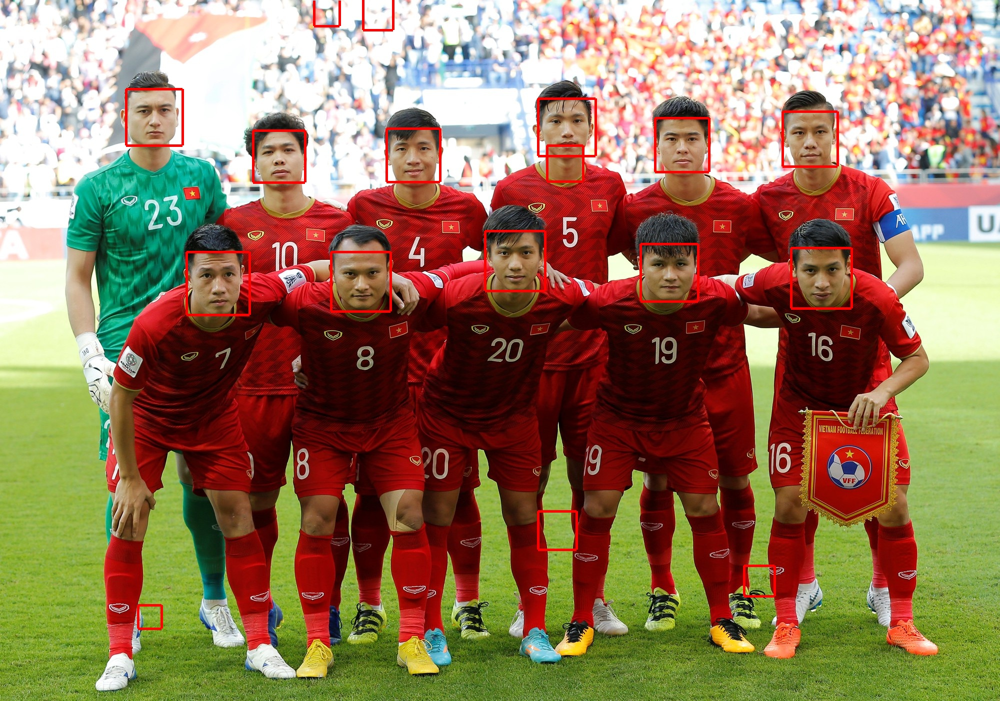

In [28]:
cv2_imshow(cv.imread('out_parallel_v0.jpg'))

In [29]:
!shasum out_sequential.jpg
!shasum out_parallel_v0.jpg

3415483d06056bc72b432987256f4350d1c7dec9  out_sequential.jpg
3415483d06056bc72b432987256f4350d1c7dec9  out_parallel_v0.jpg


**Tính đúng đắn:**
- Thí nghiệm được thực hiện với các ảnh trong thùng chứa ảnh của nhóm và đều cho thấy kết quả của cài đặt tuần tự và song song là tương đồng.

**Tính hiệu quả:**

Bảng so sánh thời gian chạy (đơn vị: ms) của phiên bản này (parallel_v0) so với phiên bản trước (sequential):

| img_name |   img_size  | sequential   | parallel_v0 |
|:--------:|:-----------:|:------------:|:-----------:|
| img1     | 2000 x 1403 | 8180.232069  |1381.296758  | 
| img2     | 1280 x 926  | 4215.944740  |1308.176827  | 
| img3     | 1280 x 869  | 3607.687201  |1428.429193  | 
| img4     | 4352.626843 | 3053.916520  |1330.095608  | 
| img5     | 2000 x 1333 | 7647.397005  |1219.654316  | 
| img6     | 1500 x 941  | 3314.664923  |1022.711290  | 
| img7     | 2000 x 1333 | 6728.792680  |1352.848613  |
| img8     | 2560 x 1739 | 14215.431376 |1550.760705  | 
| img9     | 2716 x 1810 | 11783.397713 |1517.675544  | 
| img10    | 3000 x 2000 | 13495.070273 |1559.889894  | 
| img11    | 3000 x 2000 | 12927.258606 |1572.134044  | 
| img12    | 4368 x 2912 | 24835.343178 |1927.030956  | 
| img13    | 4213 x 2809 | 28528.626331 |2043.207737  | 
| img14    | 1000 x 666  | 2097.181280  |1120.574082  | 

Thời gian chạy giảm đáng kể. Nhiều nhất là ở ảnh img13 giảm từ 28.5s xuống còn 2s.

---

# 4. Cài đặt song song + tối ưu hóa lần 1

## 4.1. Phân tích

In [30]:
!nvprof --print-gpu-trace python parallel_v0.py haarcascade_frontalface_alt.xml img1.jpg out_parallel_v0.jpg

==488== NVPROF is profiling process 488, command: python3 parallel_v0.py haarcascade_frontalface_alt.xml img1.jpg out_parallel_v0.jpg
Image size (width x height): 2000 x 1403

Number of candidates: 9810931
Number of detections: 734
Total time on host: 1414.023741 ms

Convert rgb to grayscale error:
 - Jitted vs Numpy:  0.0
 - Jitted vs Opencv: 0.47897968638631505
Calculate SAT: Pass
==488== Profiling application: python3 parallel_v0.py haarcascade_frontalface_alt.xml img1.jpg out_parallel_v0.jpg
==488== Profiling result:
   Start  Duration            Grid Size      Block Size     Regs*    SSMem*    DSMem*      Size  Throughput  SrcMemType  DstMemType           Device   Context    Stream  Name
3.62587s  1.5211ms                    -               -         -         -         -  8.0280MB  5.1542GB/s    Pageable      Device     Tesla T4 (0)         1         7  [CUDA memcpy HtoD]
3.62854s  593.27us            (63 44 1)       (32 32 1)        18        0B        0B         -           -  

Các phần được tối ưu hóa:

Ở phiên bản song song hóa trước, khi một hàm kernel của một scale (các khung cửa sổ có kích thước nhất định) đã hoàn thành thì hàm kernel của scale sau (các khung cửa sổ có kích thước lớn hơn) mới được gọi. Từ quan sát `nvprof` lẫn suy luận có thể thấy kernel của scale sau có thời gian thực thi ít hơn, do các scale càng lớn thì số lượng cửa sổ cần kiểm tra càng nhỏ và do đó chiếm ít tài nguyên hơn. Hơn nữa các kernel của các scale độc lập với nhau, do đó ta có thể song song hóa thêm để tận dụng hết tài nguyên và giảm thời gian chạy.

Trong mô hình lập trình của Cuda thì một block chỉ được giải phóng tài nguyên khi toàn bộ các thread trong block đó đều ngừng hoạt động. Kiến trúc của Cascade Classifier thì giúp vùng ảnh không phải là mặt người bị loại bỏ sớm nhất có thể, tức là các thread phụ trách những cửa sổ bị loại sẽ không phải tính toán cho các Stage sau và ngồi chơi. Qua mỗi Stage, có khoảng một nữa số lượng vùng ảnh không phải là mặt người bị loại bỏ (cụ thể tùy thuộc vào tham số lúc huấn luyện mô hình) mà hàm kernel được thiết kế để đưa vùng ảnh qua hết các Stage, do đó số lượng các thread ngồi chơi và giữ tài nguyên trong một block sẽ tăng dần qua từng Stage.

## 4.2. Thiết kế

Để song song hóa kernel của các scale khác nhau, ta tạo đủ các Stream cho mỗi scale bằng `numba.cuda.stream()`. Gọi lần lượt gọi từng hàm kernel cho mỗi scale đưa vào Stream riêng biệt, các thao tác di chuyển dữ liệu cho hàm kernel đó cũng được cho vào cùng stream, tránh stream mặc định gây tuần tự.

Để giảm số lượng thread ngồi chơi và chiếm giữ tài nguyên, ở phiên bản này, `blockSize` (số lượng thread trong một block) được *giảm*. Khi giảm `blockSize` thì `gridSize` (tổng số lượng block) sẽ tăng, xác suất một block có thread xử lý vùng ảnh là khuôn mặt (tức đi tới Stage cuối cùng, giữ block ở lại SM) giảm xuống. Do đó, tăng số lượng các block được giải phóng tài nguyên sớm.

## 4.3. Đánh giá

**Kịch bản thí nghiệm:**
- Cách đo thời gian chạy của chương trình tương tự như ở thí nghiệm của cài đặt tuần tự (mục 2.2.)
- Device: Tesla T4
- Code có chế độ sử dụng hàm chuyển ảnh xám ở host (option `--test` khi chạy code) để không có sự sai lệch khi tính toán số thực so với cài đặt tuần tự.
- Hash file ảnh đầu ra (bằng lệnh [shasum](https://linux.die.net/man/1/shasum)) của cài đặt tuần tự và cài đặt song song để kiểm tra sự tương đồng.

**Chạy code xem kết quả:**

In [45]:
!python parallel_v1.py haarcascade_frontalface_alt.xml img1.jpg out_parallel_v1.jpg --test

Image size (width x height): 2000 x 1403

Number of candidates: 9810931
Number of detections: 736
Total time on host: 1343.209335 ms

Convert rgb to grayscale error:
 - Jitted vs Numpy:  0.0006179615110477548
 - Jitted vs Opencv: 0.47841304347826086
Calculate SAT: Pass


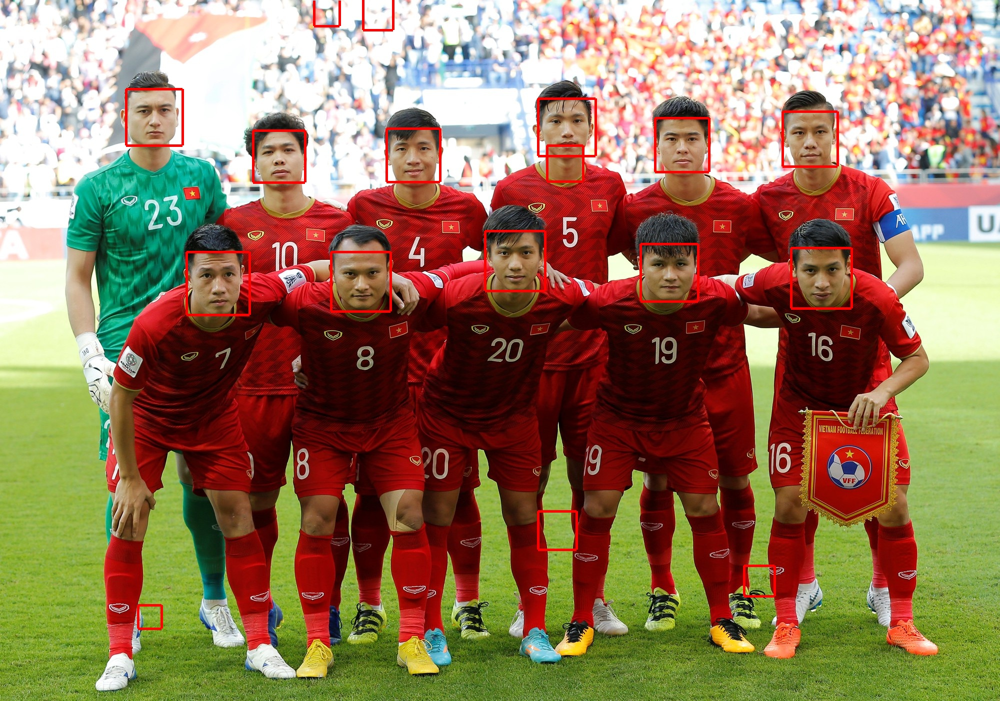

In [32]:
cv2_imshow(cv.imread('out_parallel_v1.jpg'))

In [33]:
!shasum out_sequential.jpg
!shasum out_parallel_v1.jpg

3415483d06056bc72b432987256f4350d1c7dec9  out_sequential.jpg
3415483d06056bc72b432987256f4350d1c7dec9  out_parallel_v1.jpg


**Tính đúng đắn:**
- Thí nghiệm được thực hiện với các ảnh trong thùng chứa ảnh của nhóm và đều cho thấy kết quả của cài đặt tuần tự và song song là tương đồng.

**Tính hiệu quả:**

Bảng so sánh thời gian chạy (đơn vị: ms) của phiên bản này (parallel_v1) so với phiên bản trước (parallel_v0):

| img_name |   img_size  | parallel_v0 | parallel_v1 |
|:--------:|:-----------:|:-----------:|:-----------:|
| img1     | 2000 x 1403 | 1381.296758 | 1251.178935 |
| img2     | 1280 x 926  | 1308.176827 | 1162.215218 |
| img3     | 1280 x 869  | 1428.429193 | 1260.275345 |
| img4     | 4352.626843 | 1330.095608 | 1070.844844 |
| img5     | 2000 x 1333 | 1219.654316 | 1255.950361 |
| img6     | 1500 x 941  | 1022.711290 | 1086.462153 |
| img7     | 2000 x 1333 | 1352.848613 | 1197.845853 | 
| img8     | 2560 x 1739 | 1550.760705 | 1340.381858 |
| img9     | 2716 x 1810 | 1517.675544 | 1330.410476 |
| img10    | 3000 x 2000 | 1559.889894 | 1395.517975 |
| img11    | 3000 x 2000 | 1572.134044 | 1380.480402 |
| img12    | 4368 x 2912 | 1927.030956 | 1701.921247 |
| img13    | 4213 x 2809 | 2043.207737 | 1750.221087 |
| img14    | 1000 x 666  | 1120.574082 | 999.685232  |

Thời gian chạy giảm khoảng 100 đến 300 ms.

---

# 5. Cài đặt song song + tối ưu hóa lần 2

## 5.1. Phân tích

Giống với phân tích số lượng thread chiếm giữ tài nguyên lãng phí của mục 4.1. Phiên bản này sẽ cải thiện theo cách khác chủ động hơn việc giảm `blockSize`.

## 5.2. Thiết kế

Các stage sẽ được gom nhóm thành các segment (phân đoạn) để được thực thi trong cùng một hàm kernel, thay vì trước đây chỉ có 1 segment là toàn bộ các stage. Ví dụ: có 30 stage, có thể chia làm 3 segment là 1->5, 6->15, 16->30.

Hàm kernel nhận thêm 2 đối số là stage đầu tiên và stage cuối cùng mà nó cần kiểm tra. Giống như hàm kernel ban đầu, hàm kernel mới cũng sẽ kết thúc sớm nếu một trong các stage từ chối vùng ảnh. 

Khi hàm kernel đã chạy xong một segment, nó sẽ được gọi lại để chạy segment tiếp theo. Điểm mấu chốt là mỗi hàm kernel sẽ ghi nhận lại vị trí và số lượng những khung cửa sổ vượt qua stage cuối cùng của segment mà nó thực thi để hàm kernel của segment sau có thể tính lại `gridSize` sao cho vừa đủ thread để kiểm tra các cửa sổ "còn sống" từ segment trước. Như vậy sẽ hạn chế số lượng thread ngồi chơi và chiếm tài nguyên.

Để đếm số lượng ta cần một biến đếm chung và dùng `numba.cuda.atomicAdd` để tránh đụng độ khi nhiều thread cộng vào biến này cùng lúc.

Việc ghi nhận lại cửa sổ nào đã vượt qua stage cuối cùng của một segment sẽ tận dụng biến đếm này để ghi tọa độ của các của sổ vào mảng kết quả 1 chiều. Thread sẽ lấy giá trị trả về của toán tử atomicAdd (tức giá trị cũ của biến đếm trước khi cộng) làm chỉ số để ghi tọa độ của cửa sổ vào mảng. Và kết quả là ta có tọa độ của các của sổ còn sống nằm liên tục ở phía đầu mảng để hàm kernel cho segment sau có thể rải quân vừa đủ số lượng các thread lên mảng này.

Thiết kế trên để giảm số lượng thread chiếm tài nguyên lãng phí. Tiếp theo, cần tận dụng tài nguyên đã lấy lại được bằng cách dùng stream để đưa các kernel của các scale sau vào các stream khác nhau (như ở phiên bản trước). 

Như vậy, ta mong đợi các kernel của các scale có thể overlap, nhưng các kernel này chỉ thực thi một segment và khi nó kết thúc thì kernel cho segment sau cần được đẩy vào stream. Do không thể đẩy hết kernel của các segment vào stream sẵn đơn giản vì thiết kế ban đầu là khi 1 segment hoàn thành mới biết đúng số lượng cửa sổ còn sống để cấp số thread vừa đủ nhu cầu cho segment sau). Làm sao để biết kernel của scale nào đã hoàn thành để đẩy kernel cho segment sau của scale đó vào stream?

Cách của nhóm là dùng `numba.cuda.event` nhét vào phía sau mỗi kernel của các scale. Trong khi device đang làm việc, host sẽ liên tục duyệt qua các event và kiểm tra event này đã ra khỏi stream của nó hay chưa. Nếu rồi thì nghĩa là hàm kernel thuộc stream này là hoàn thành và ta tiến hành đưa hàm kernel thực thi segment sau vào.

## 5.3. Đánh giá

**Kịch bản thí nghiệm:**
- Cách đo thời gian chạy của chương trình tương tự như ở thí nghiệm của cài đặt tuần tự (mục 2.2.)
- Device: Tesla T4
- Code có chế độ sử dụng hàm chuyển ảnh xám ở host (option `--test` khi chạy code) để không có sự sai lệch khi tính toán số thực so với cài đặt tuần tự.

**Chạy code xem kết quả:**

In [41]:
!python parallel_v2.py haarcascade_frontalface_alt.xml img1.jpg out_parallel_v2.jpg --test

Image size (width x height): 2000 x 1403

Number of detections: 736
Total time on host: 1367.006157 ms

Convert rgb to grayscale error:
 - Jitted vs Numpy:  0.0006179615110477548
 - Jitted vs Opencv: 0.47841304347826086
Calculate SAT: Pass


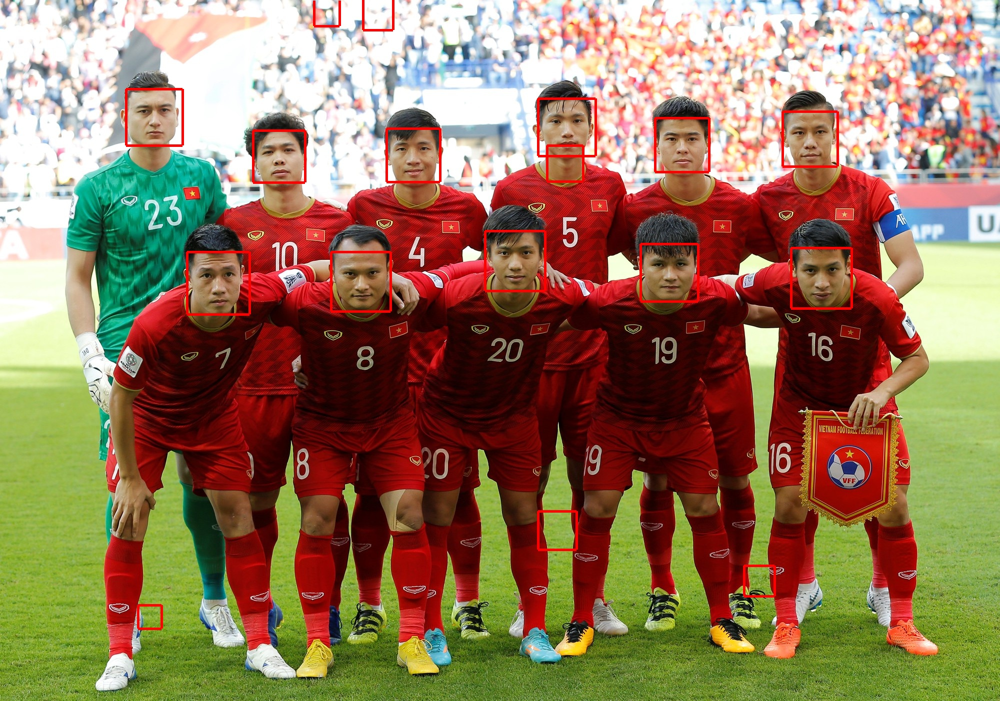

In [38]:
cv2_imshow(cv.imread('out_parallel_v2.jpg'))

In [39]:
!shasum out_sequential.jpg
!shasum out_parallel_v2.jpg

3415483d06056bc72b432987256f4350d1c7dec9  out_sequential.jpg
637feddc3d8c4023339b03e46eec3df51bdda821  out_parallel_v2.jpg


**Tính đúng đắn:**
- Hash file ảnh đầu ra của cài đặt tuần tự và cài đặt song song phiên bản này không giống nhau do có sự sai khác khi gom nhóm cửa sổ. Cụ thể là phiên bản này dùng atomicAdd để các thread ghi kết quả cùng lúc nên không đảm bảo thứ tự các cửa sổ trong mảng kết quả giống như thứ tự duyệt tuần tự. Ở bước hậu xử lý các cửa sổ sẽ được gom nhóm và tính trung bình để ra một bouding box đại diện cho nhóm, thứ tự của các cửa sổ trong mảng các cửa sổ ảnh hưởng tới kết quả gom nhóm. Ví dụ A gần B, B gần C nhưng C không gần A, thứ tự trong mảng các cửa sổ là [A, B, C] và thuật toán tìm nhóm cho một của sổ là nhóm đầu tiên từ duyệt từ trái sang thì B sẽ chung nhóm A, C chung nhóm với B nên cả A, B, C chung nhóm. Nhưng nếu mảng các cửa sổ là [A, C, B] thì sẽ có 2 nhóm là [C] và [A, B].
- Số detection (khung cửa sổ vượt qua stage cuối cùng) của phiên bản này đều bằng cài đặt tuần tự ở các hình mà nhóm thí nghiệm.
- Quan sát kết quả cũng không thấy khác biệt về số lượng bouding box trong các ảnh kết quả của phiên bản này và cài đặt tuần tự.

**Tính hiệu quả:**

Bảng so sánh thời gian chạy (đơn vị: ms) của phiên bản này (parallel_v2) so với phiên bản trước (parallel_v1):

| img_name |   img_size  | parallel_v1 | parallel_v2  |
|:--------:|:-----------:|:-----------:|:------------:|
| img1     | 2000 x 1403 | 1251.178935 | 1331.522365  |
| img2     | 1280 x 926  | 1162.215218 | 1165.327074  |
| img3     | 1280 x 869  | 1260.275345 | 1286.127107  |
| img4     | 4352.626843 | 1070.844844 | 1110.148736  |
| img5     | 2000 x 1333 | 1255.950361 | 1265.248559  |
| img6     | 1500 x 941  | 1086.462153 | 1130.282722  |
| img7     | 2000 x 1333 | 1197.845853 | 1228.954600  | 
| img8     | 2560 x 1739 | 1340.381858 | 1406.023380  |
| img9     | 2716 x 1810 | 1330.410476 | 1378.151961  |
| img10    | 3000 x 2000 | 1395.517975 | 1428.714095  |
| img11    | 3000 x 2000 | 1380.480402 | 1450.894644  |
| img12    | 4368 x 2912 | 1701.921247 | 1726.681382  |
| img13    | 4213 x 2809 | 1750.221087 | 1785.064799  |
| img14    | 1000 x 666  | 999.685232  | 1076.415267  |

Thời gian chạy xấp xỉ và có phần chậm hơn một chút so với phiên bản trước.

Nguyên nhân:
- Cách chia segment chưa tối ưu?
- Overhead quá lớn?
- (đang tìm hiểu thêm)

---

# 6. Nhìn lại quá trình làm đồ án

---

# 7. Tham khảo

Bài báo của Viola & Jones - [Robust Real-time Object Detection](https://web.archive.org/web/20130326212314/http://research.microsoft.com/en-us/um/people/viola/Pubs/Detect/violaJones_IJCV.pdf)